## 5 - Area-of-Interest Cluster Analysis

##### Import

In [4]:
import os
import ast
import pandas as pd
import numpy as np
import scipy as su

from matplotlib.path import Path
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
import hdbscan

import dask.dataframe as dd

##### Data Loading

In [6]:
# Load AoI ddfs into dictionary
root_dir = './aoi_data'
def load_aoi_data(root_dir, exception=False): # Get csv file reads into one dictionary
    data = {}
    for file in os.listdir(root_dir):
        file_path = os.path.join(root_dir, file)
        file_name = os.path.splitext(file)[0]  # file name without '.csv'
        data[file_name] = dd.read_csv(file_path)  # read and attach to dict
    return data

data = load_aoi_data(root_dir)
participant_ids = [1,2,4,5,6,7,8,9,10,12,13,14,15,16,17,18,19,20]

In [7]:
# AoI data (task based)
ddf = data['aoi']
df = ddf.compute()
df = df.dropna(subset=['task_id'])

rel_cols = ['participant_id', 'duration', 'norm_pos_x', 'norm_pos_y']
df = df[rel_cols]

In [8]:
# Define Visualization function
bg_img = plt.imread('./images/AOI_division.png')
def visualize (data, x_col, y_col, cluster_col, title):
    plt.figure(figsize=(16, 9))

    plt.title(title, fontsize=24, weight='medium')
    plt.imshow(
        bg_img,
        extent=(0, 1, 0, 1),
        aspect='auto'
    )
    if cluster_col:
        plt.scatter(data[x_col], data[y_col], c=data[cluster_col], s=.1)
    else:
        plt.scatter(data[x_col], data[y_col], s=.1)

    plt.xlabel('', fontsize=20)
    plt.ylabel('', fontsize=20)
    plt.xticks([])
    plt.yticks([])
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.show()

### 1. Fixation graph

##### Scatterplot of coordinates

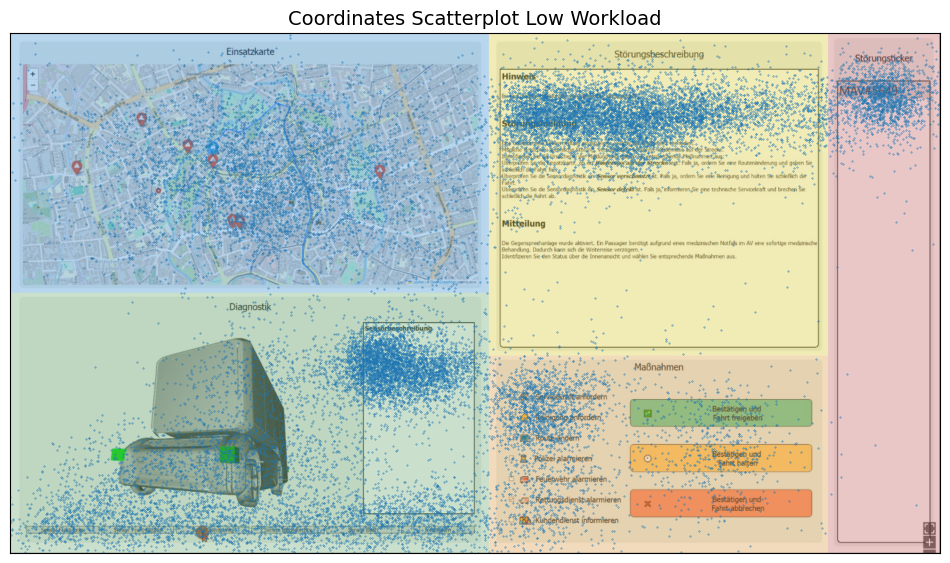

In [5]:
# Scatterplot
df_low = data['aoi'].compute().dropna().query('condition == 1')
visualize (df_low, 'norm_pos_x', 'norm_pos_y', None, 'Coordinates Scatterplot Low Workload')

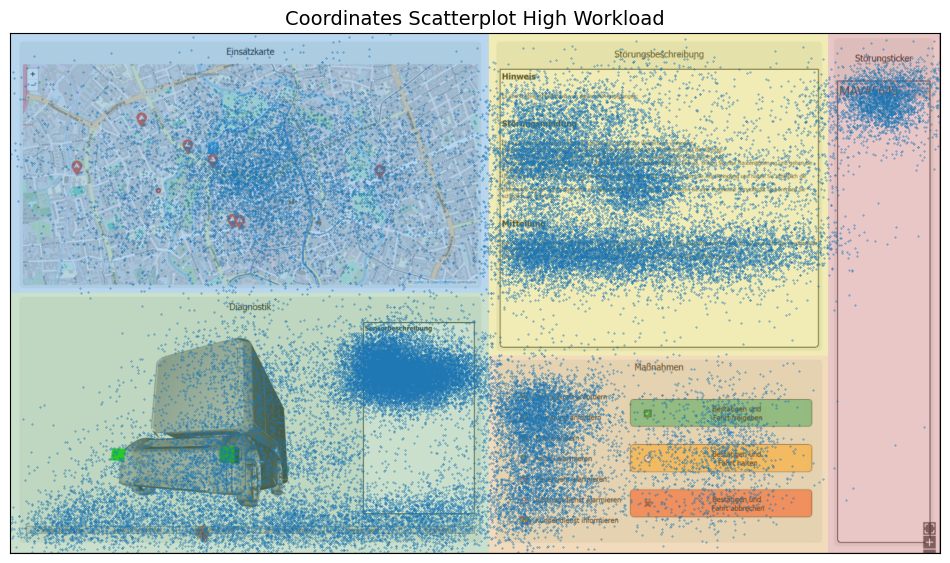

In [6]:
# Scatterplot
df_high = data['aoi'].compute().dropna().query('condition == 4')
visualize (df_high, 'norm_pos_x', 'norm_pos_y', None, 'Coordinates Scatterplot High Workload')

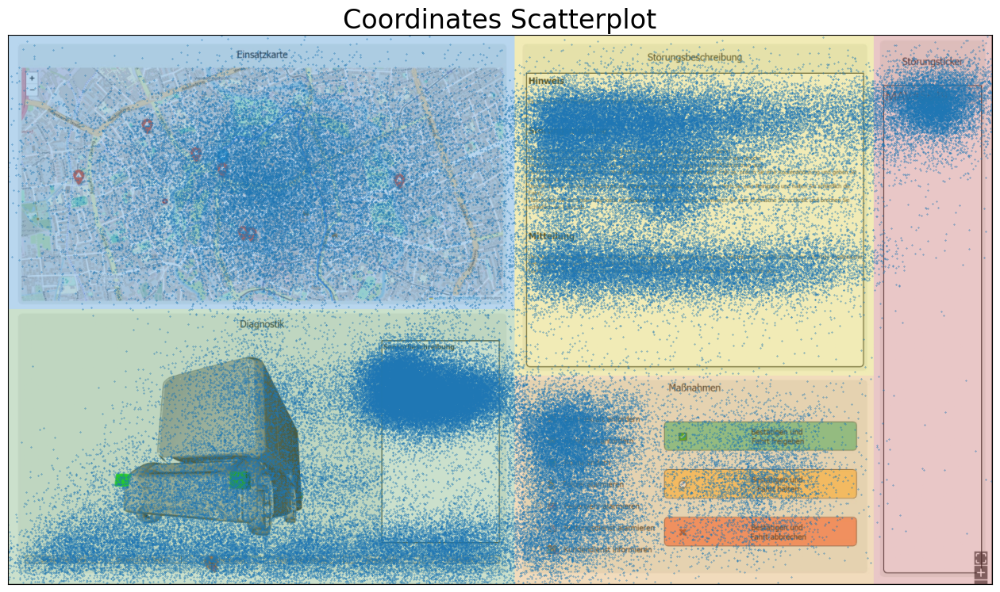

In [9]:
# Scatterplot
visualize (df, 'norm_pos_x', 'norm_pos_y', None, 'Coordinates Scatterplot')

##### Heatmap

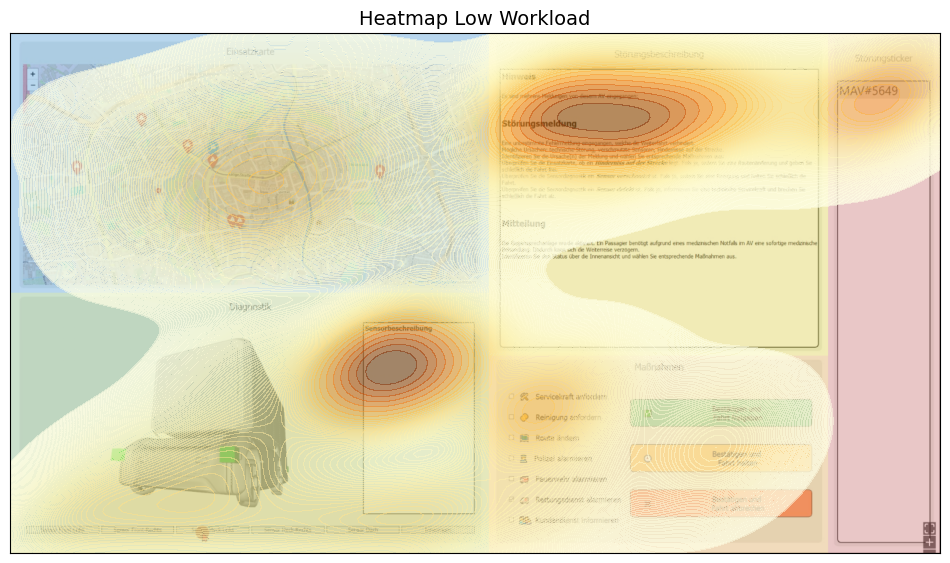

In [7]:
# Heatmap
plt.figure(figsize=(12, 6.75))
bg_img = plt.imread('./images/AOI_division.png')

plt.title('Heatmap Low Workload', fontsize=14, weight='medium')
plt.imshow(
    bg_img,
    extent=(0, 1, 0, 1),
    aspect='auto'
)

sns.kdeplot(
    x=df_low['norm_pos_x'],
    y=df_low['norm_pos_y'],
    levels=np.logspace(-2, 0, 100),
    hue_norm=(0, 1),
    fill=True,
    cmap=sns.color_palette("YlOrBr", as_cmap=True),
    alpha=.5
)

plt.xlabel('')
plt.ylabel('')
plt.xticks([])
plt.yticks([])
plt.xlim(0, 1)
plt.ylim(0, 1)
plt.show()

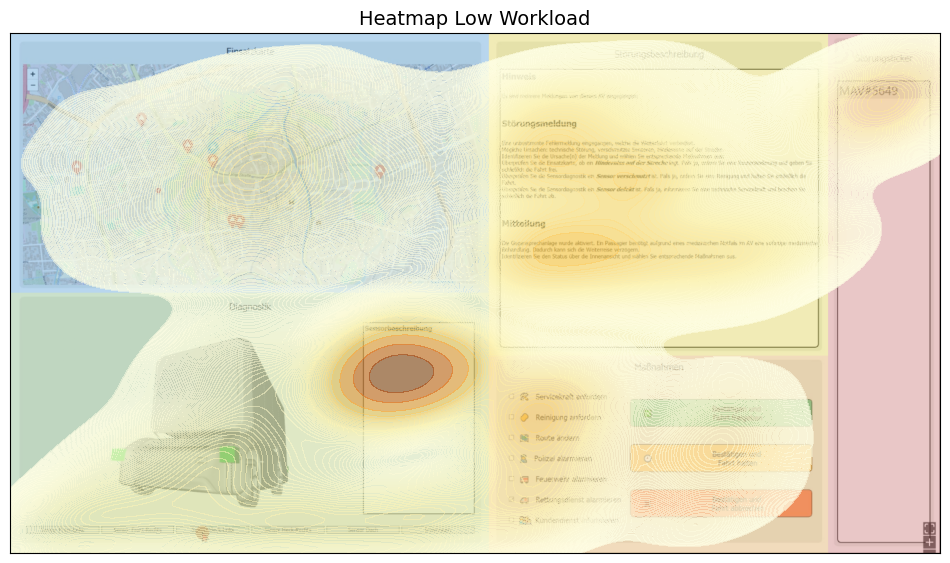

In [8]:
# Heatmap
plt.figure(figsize=(12, 6.75))
bg_img = plt.imread('./images/AOI_division.png')

plt.title('Heatmap Low Workload', fontsize=14, weight='medium')
plt.imshow(
    bg_img,
    extent=(0, 1, 0, 1),
    aspect='auto'
)

sns.kdeplot(
    x=df_high['norm_pos_x'],
    y=df_high['norm_pos_y'],
    levels=np.logspace(-2, 0, 100),
    hue_norm=(0, 1),
    fill=True,
    cmap=sns.color_palette("YlOrBr", as_cmap=True),
    alpha=.5
)

plt.xlabel('')
plt.ylabel('')
plt.xticks([])
plt.yticks([])
plt.xlim(0, 1)
plt.ylim(0, 1)
plt.show()

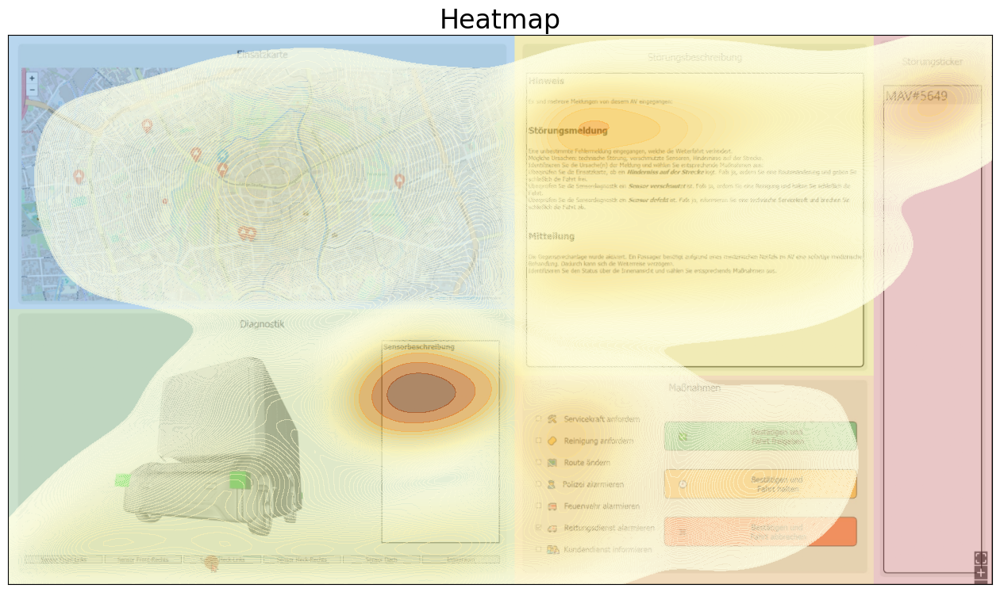

In [10]:
# Heatmap
plt.figure(figsize=(16, 9))
bg_img = plt.imread('./images/AOI_division.png')

plt.title('Heatmap', fontsize=24, weight='medium')
plt.imshow(
    bg_img,
    extent=(0, 1, 0, 1),
    aspect='auto'
)

sns.kdeplot(
    x=df['norm_pos_x'],
    y=df['norm_pos_y'],
    levels=np.logspace(-2, 0, 100),
    hue_norm=(0, 1),
    fill=True,
    cmap=sns.color_palette("YlOrBr", as_cmap=True),
    alpha=.5
)

plt.xlabel('', fontsize=20)
plt.ylabel('', fontsize=20)
plt.xticks([])
plt.yticks([])
plt.xlim(0, 1)
plt.ylim(0, 1)
plt.tick_params(axis='both', which='major', labelsize=16)
plt.show()

### 2. Cluster Analysis

##### K-Means Clustering

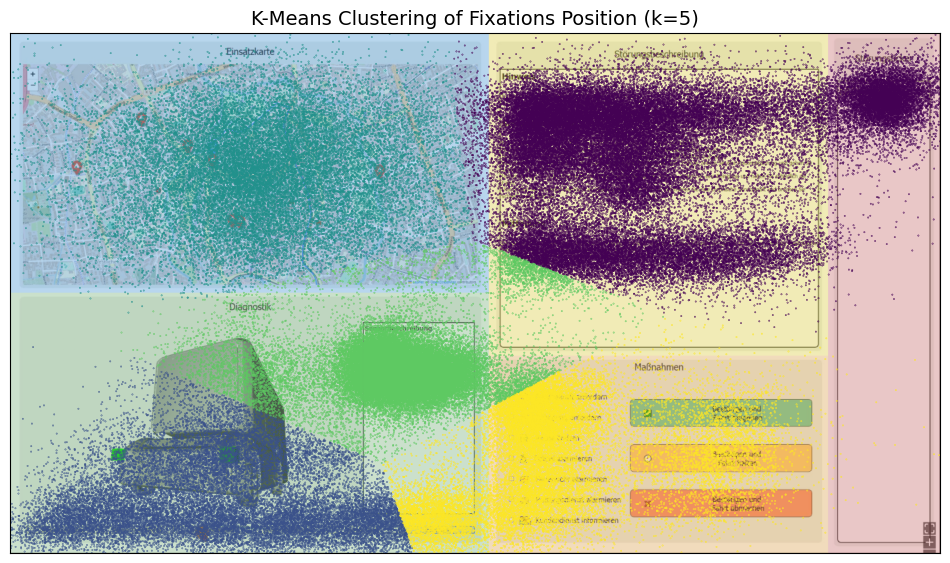

In [19]:
# Perform analysis (k=5)
coordinates = df[['norm_pos_x', 'norm_pos_y']]

kmeans = KMeans(n_clusters=5, random_state=42)
df['cluster'] = kmeans.fit_predict(coordinates)

visualize (df, 'norm_pos_x', 'norm_pos_y', 'cluster', 'K-Means Clustering of Fixations Position (k=5)')

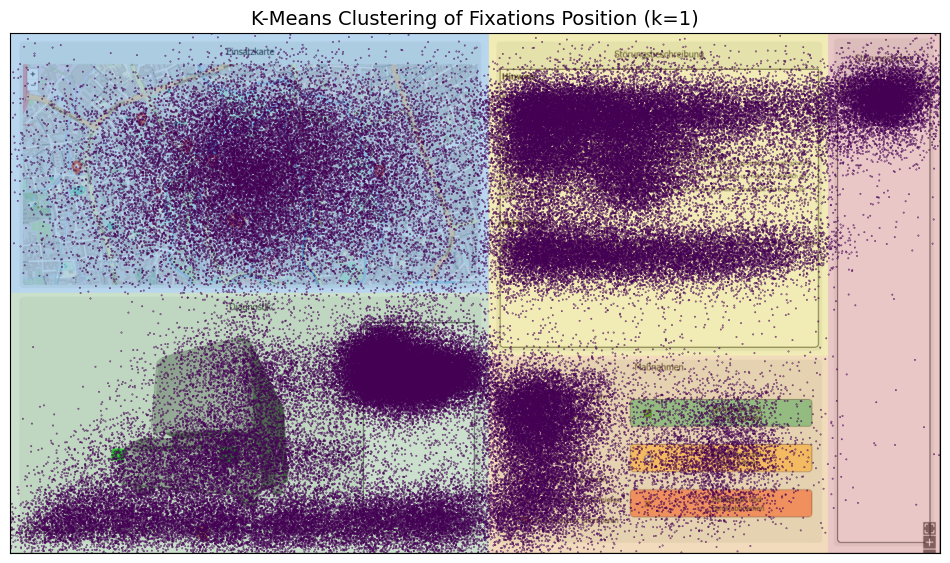

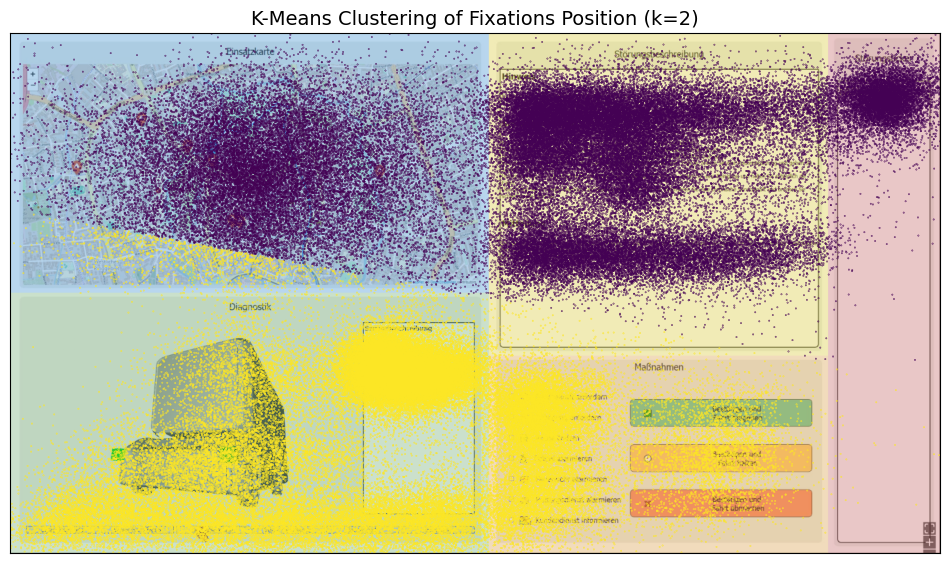

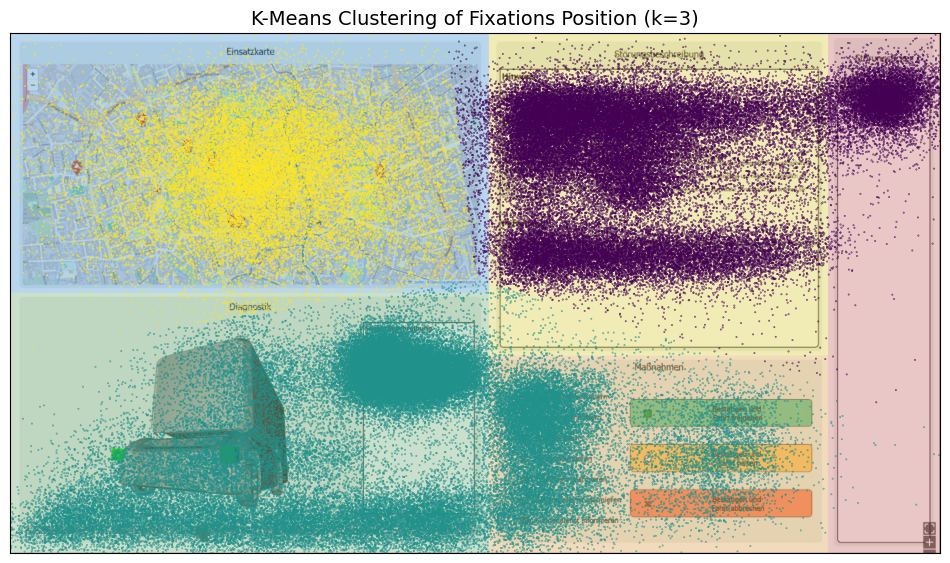

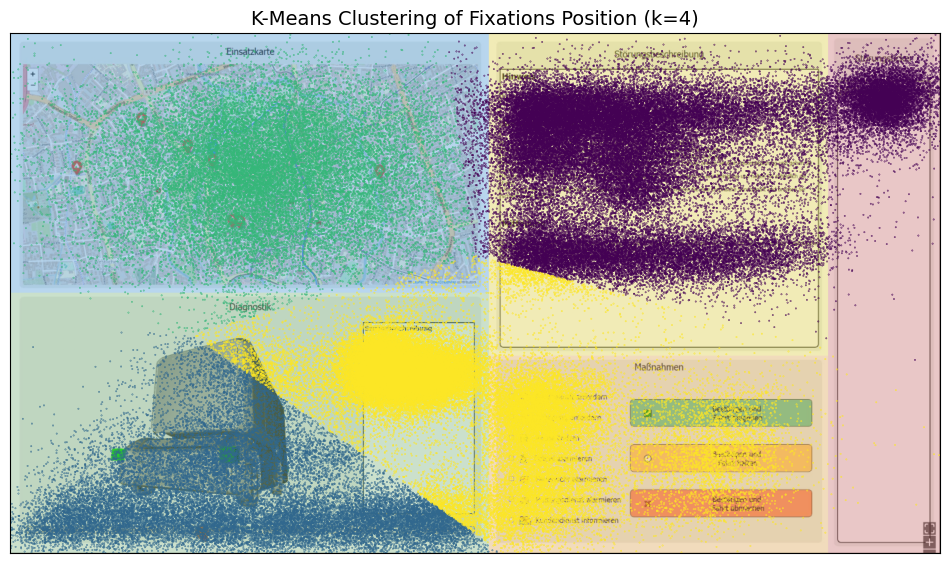

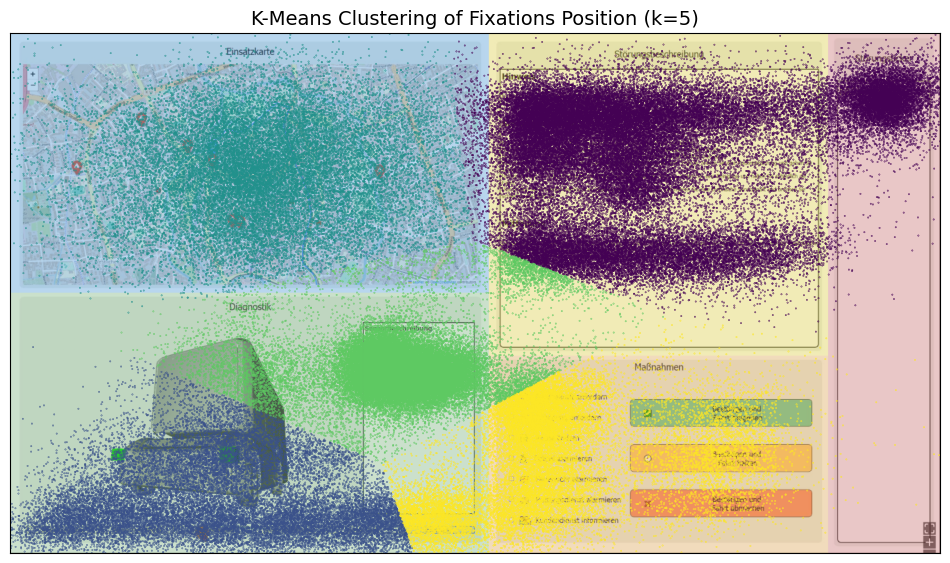

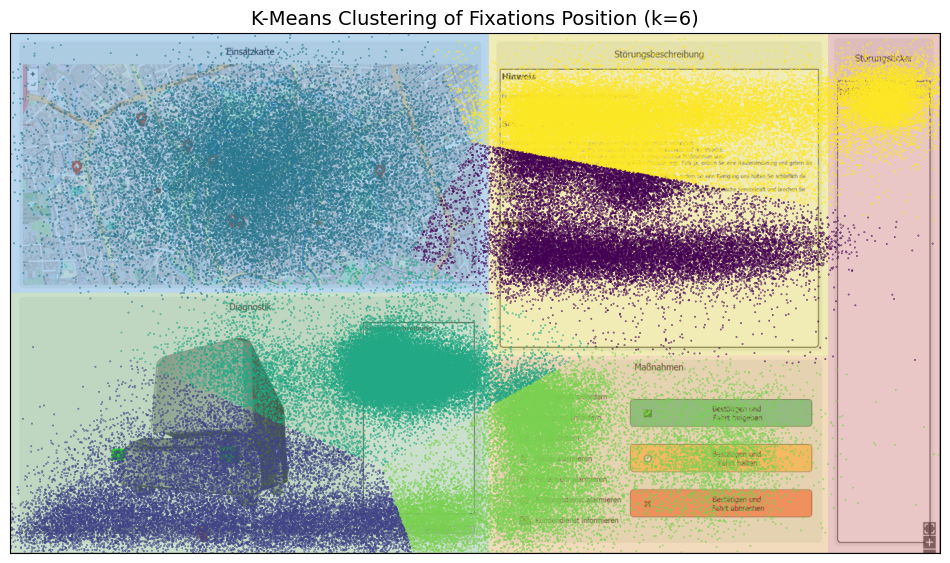

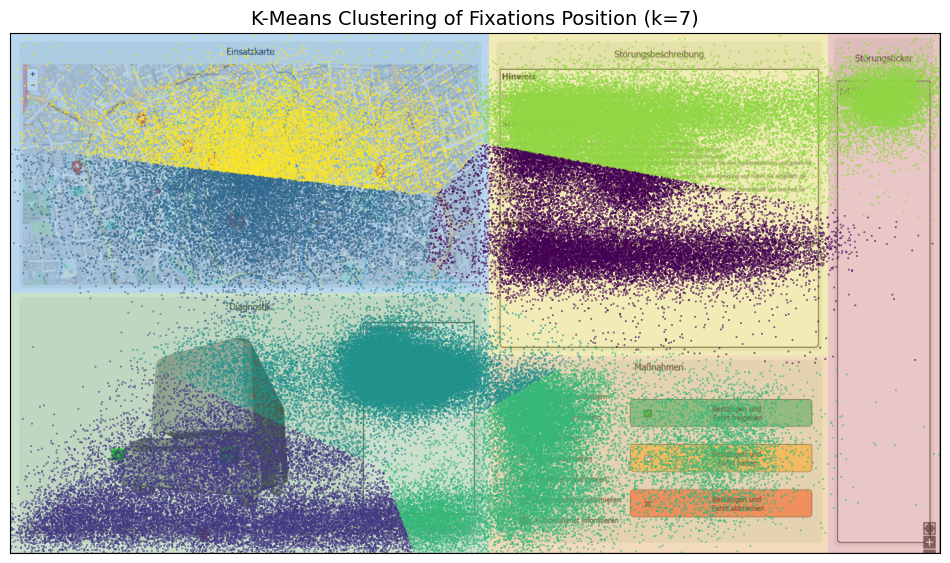

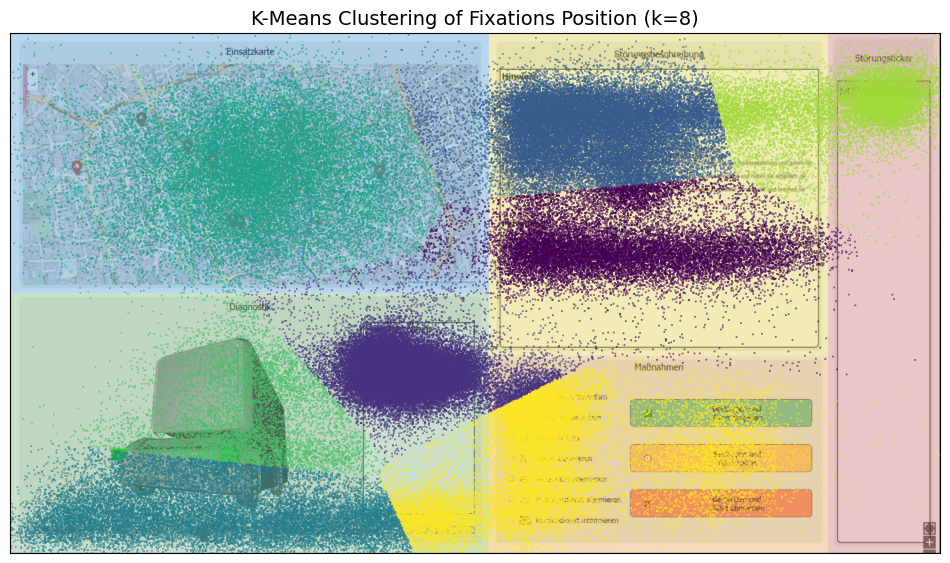

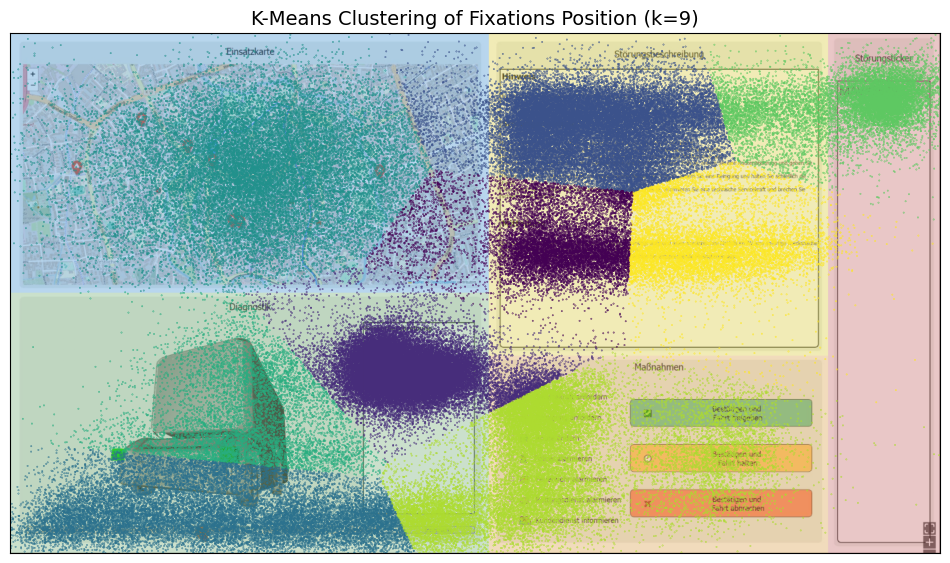

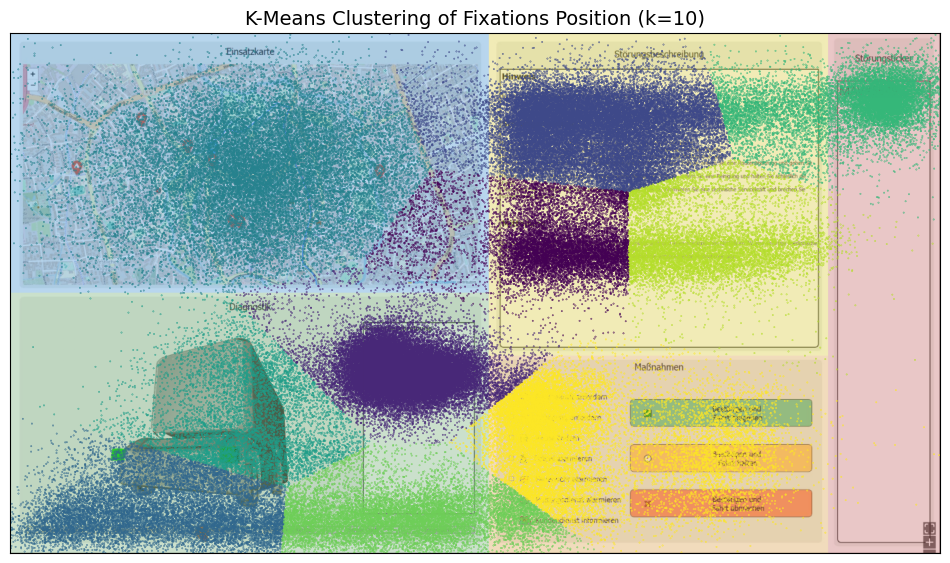

In [20]:
# Perform analysis (k from 1 to 10)
coordinates = df[['norm_pos_x', 'norm_pos_y']]

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    df['cluster'] = kmeans.fit_predict(coordinates)

    visualize (df, 'norm_pos_x', 'norm_pos_y', 'cluster', f'K-Means Clustering of Fixations Position (k={k})')

##### Weighted K-Means Clustering

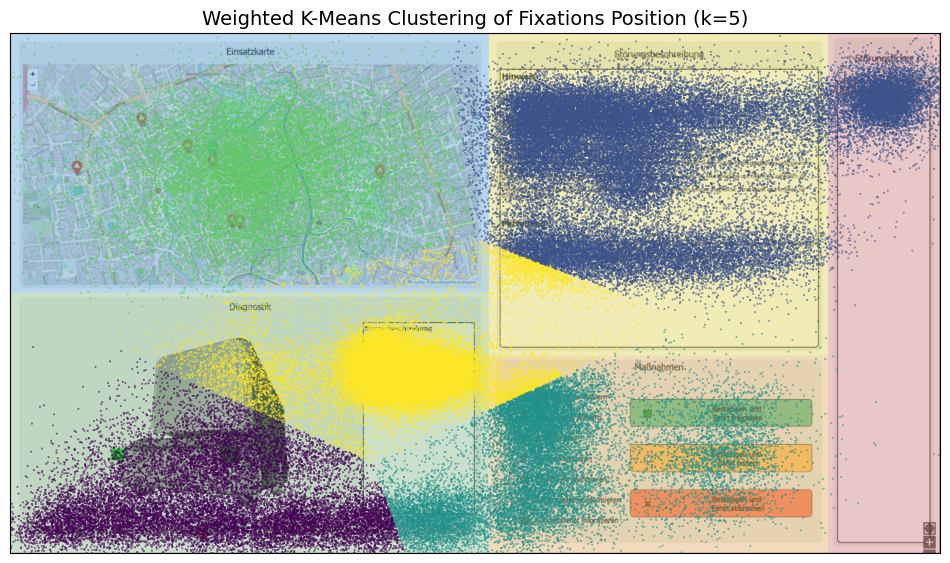

In [21]:
# Perform analysis (k=5)
coordinates = df[['norm_pos_x', 'norm_pos_y']]

df['norm_duration'] = (df['duration'] - 80) / (220 - 80)
repeat_count = (df['norm_duration'] * 10).astype(int)
weighted_coordinates = np.repeat(coordinates[['norm_pos_x', 'norm_pos_y']].values, repeat_count, axis=0)

kmeans = KMeans(n_clusters=5, random_state=42)
weighted_clusters = kmeans.fit_predict(weighted_coordinates)
repeated_index = df.index.repeat(repeat_count)
df['cluster'] = pd.Series(weighted_clusters).groupby(repeated_index).agg(lambda x: x.value_counts().index[0])

visualize (df, 'norm_pos_x', 'norm_pos_y', 'cluster', 'Weighted K-Means Clustering of Fixations Position (k=5)')

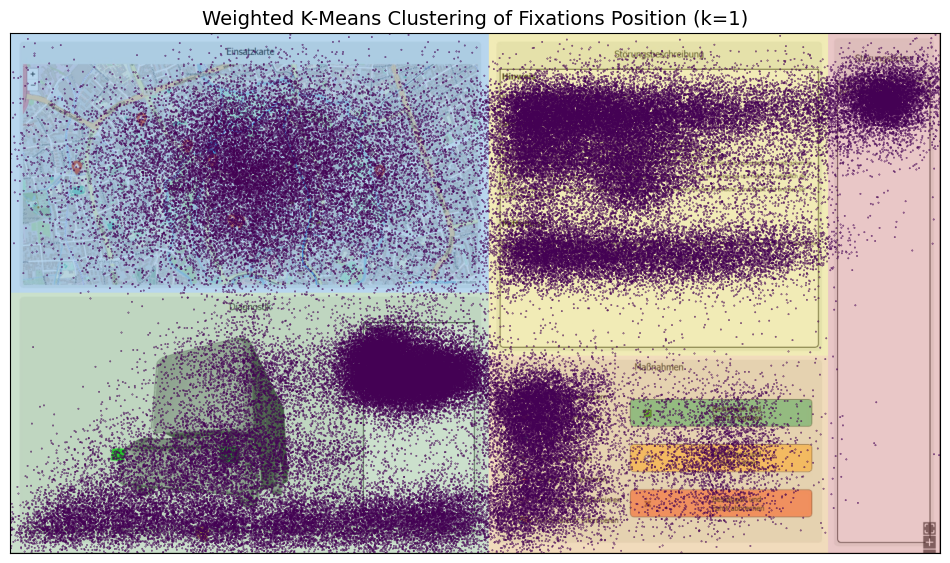

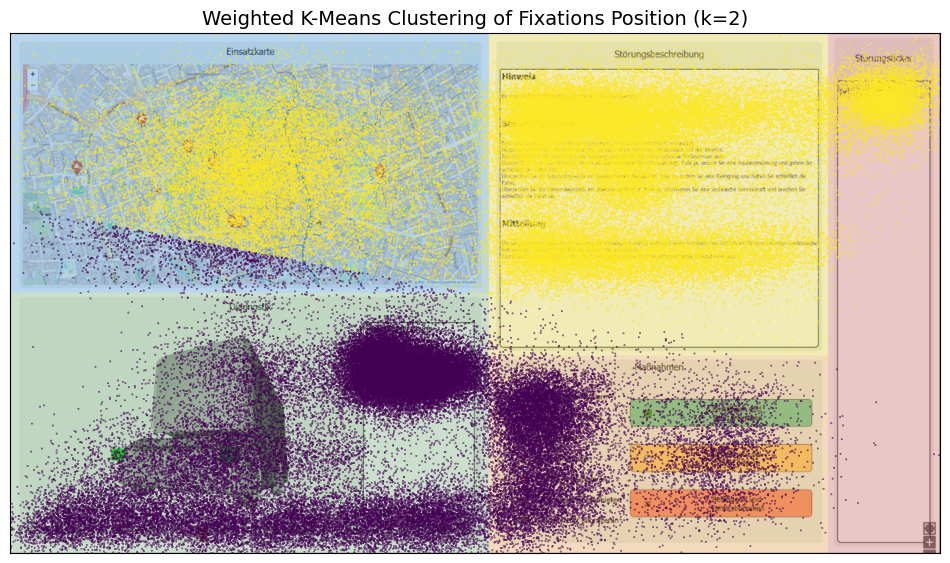

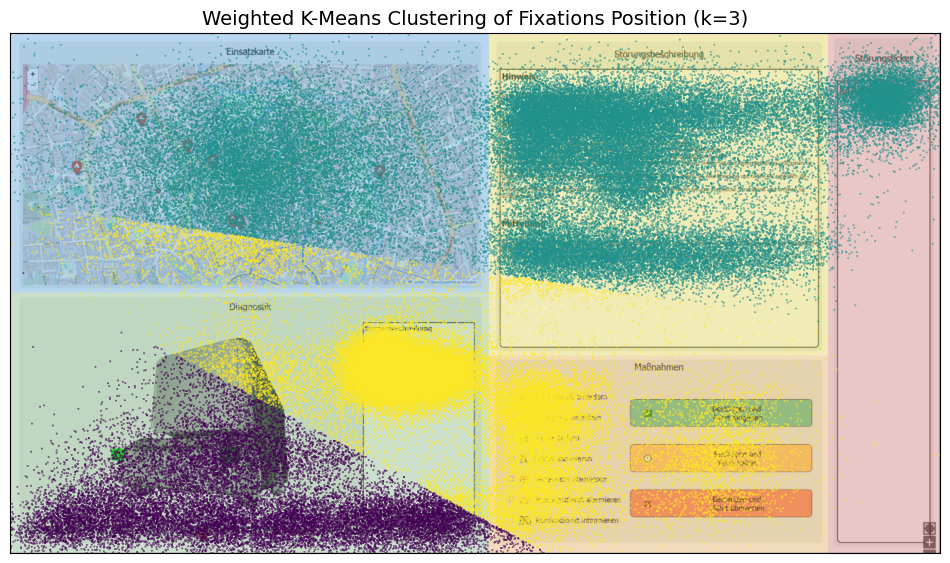

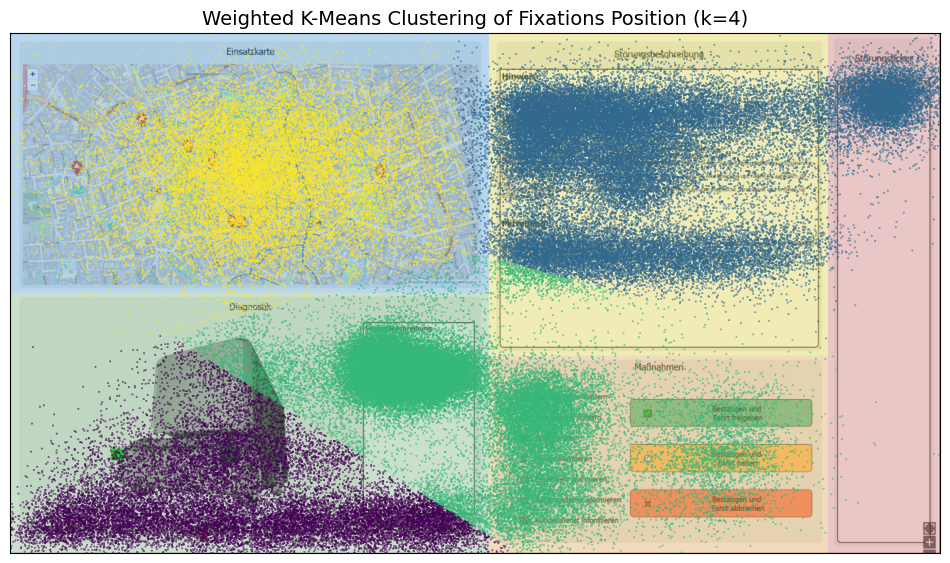

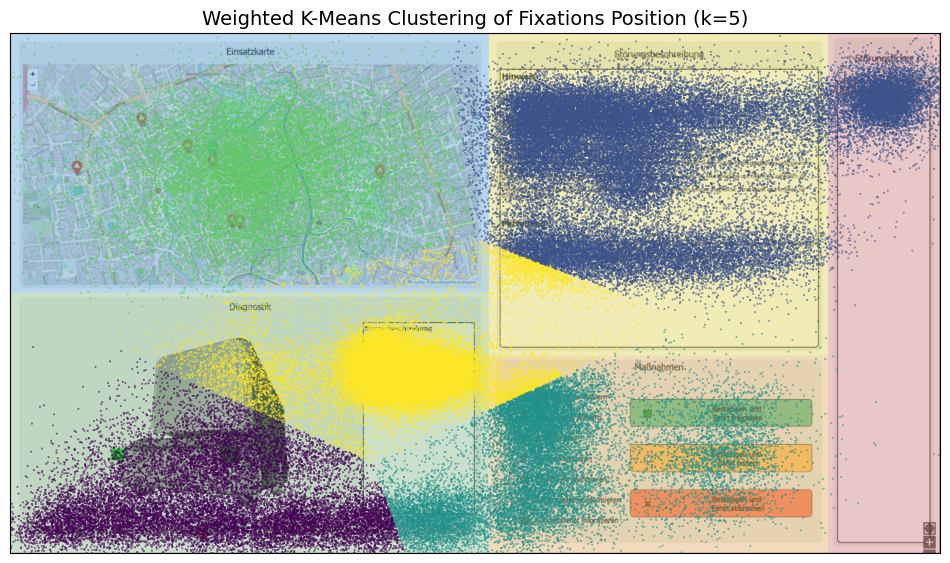

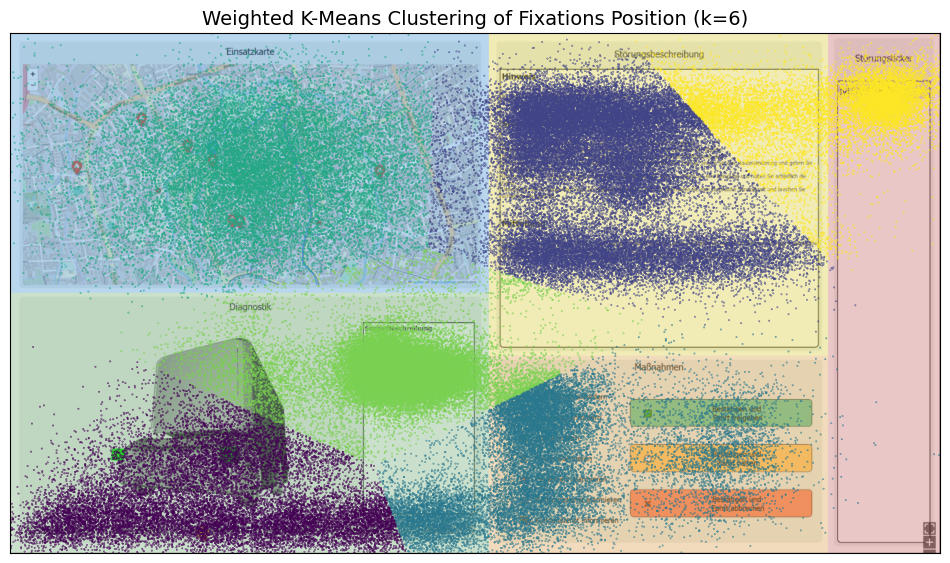

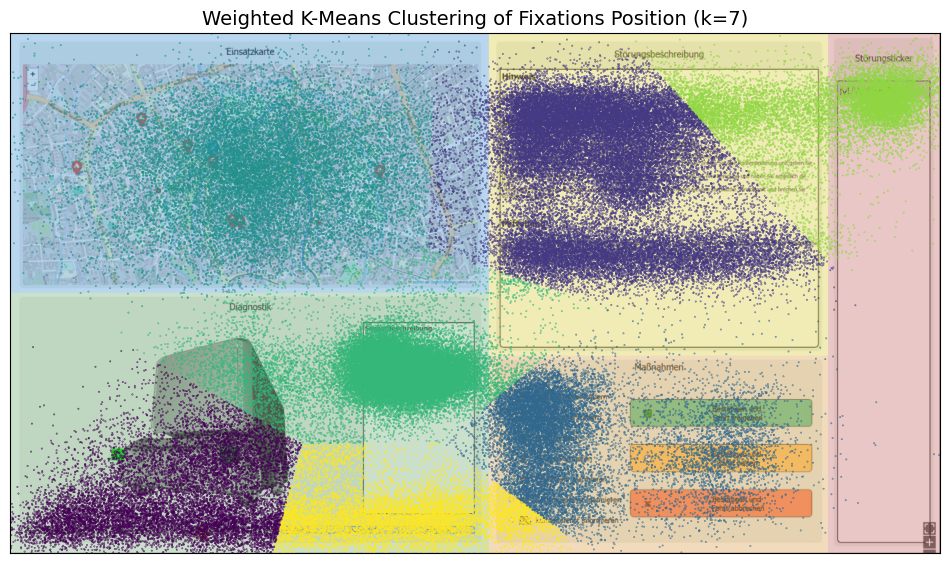

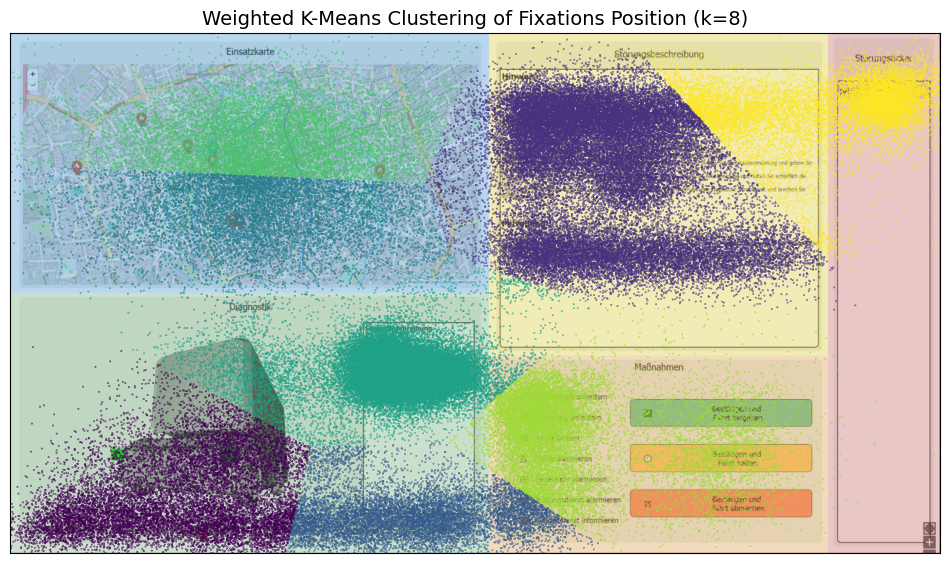

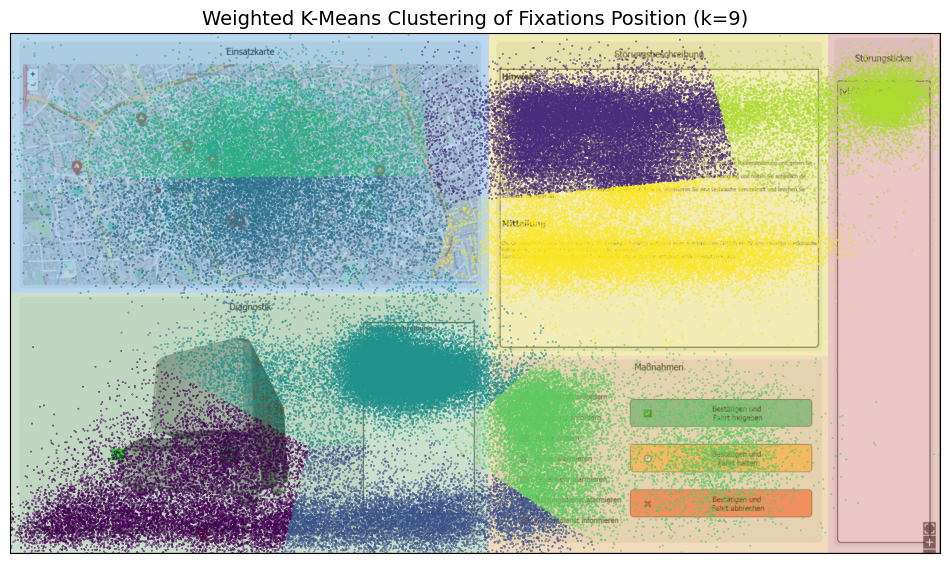

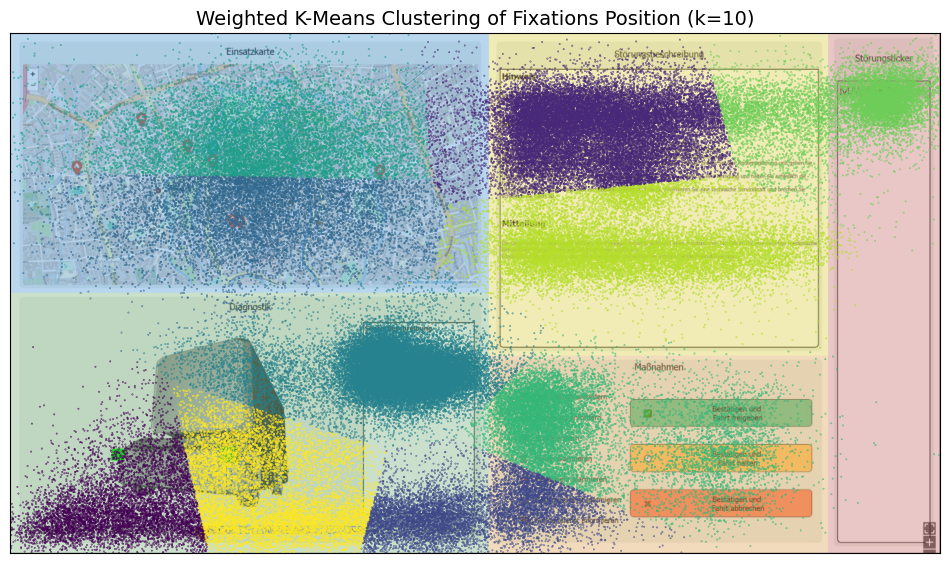

In [22]:
# Perform analysis (k from 1 to 10)
coordinates = df[['norm_pos_x', 'norm_pos_y']]

df['norm_duration'] = (df['duration'] - 80) / (220 - 80)
repeat_count = (df['norm_duration'] * 10).astype(int)
weighted_coordinates = np.repeat(coordinates[['norm_pos_x', 'norm_pos_y']].values, repeat_count, axis=0)

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    weighted_clusters = kmeans.fit_predict(weighted_coordinates)
    repeated_index = df.index.repeat(repeat_count)
    df['cluster'] = pd.Series(weighted_clusters).groupby(repeated_index).agg(lambda x: x.value_counts().index[0])

    visualize (df, 'norm_pos_x', 'norm_pos_y', 'cluster', f'Weighted K-Means Clustering of Fixations Position (k={k})')

##### HDBSCAN Clustering

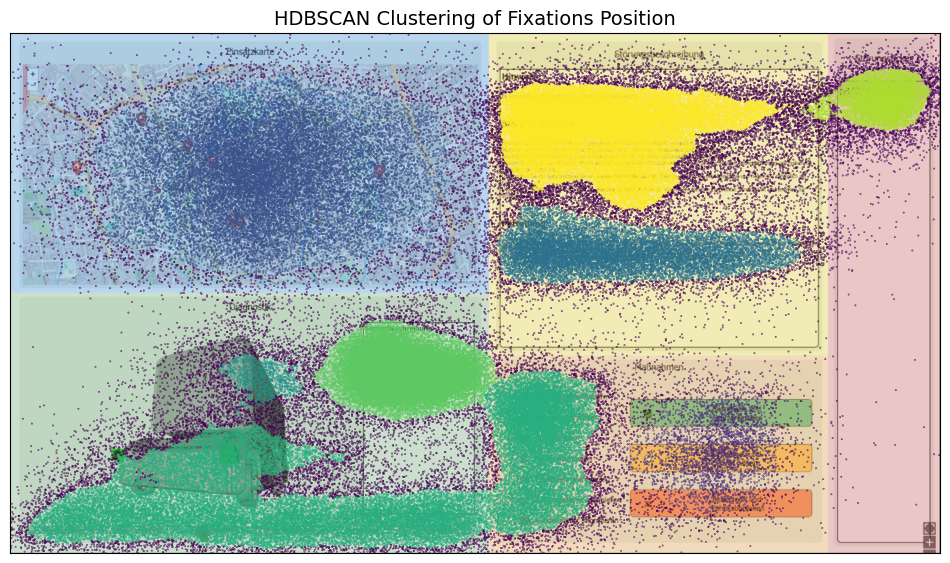

In [23]:
# Perform analysis (min_size=100)
hdbscan_clusterer = hdbscan.HDBSCAN(min_cluster_size=100, metric='euclidean')
df['cluster'] = hdbscan_clusterer.fit_predict(coordinates)

visualize (df, 'norm_pos_x', 'norm_pos_y', 'cluster', 'HDBSCAN Clustering of Fixations Position')

### 3. Results
HDBSCAN Clustering

In [11]:
# Define visualization function with aoi bounds
coordinates = df[['norm_pos_x', 'norm_pos_y']]
areas_of_interest = {
    'Ticket': [(0.88, 1), (1, 1), (1, 0), (0.88, 0)],
    'Description': [(0.515, 1), (0.88, 1), (0.88, 0.39), (0.515, 0.39)],
    'Map': [(0, 1), (0.515, 1), (0.515, 0.5), (0, 0.5)],
    'Diagnostic': [(0, 0.5), (0.515, 0.5), (0.515, 0), (0, 0)],
    'Action': [(0.515, 0.39), (0.88, 0.39), (0.88, 0), (0.515, 0)]
}

def visualize_with_bounds(clusters, noise, title, subtitle):
    plt.figure(figsize=(12, 6.75))

    plt.suptitle(title, fontsize=14, weight='medium')
    plt.title(subtitle, fontsize=8, weight='light')
    plt.subplots_adjust(top=.91)
    plt.imshow(
        bg_img,
        extent=(0, 1, 0, 1),
        aspect='auto'
    )

    ax = plt.gca()  # Get current axis
    for area_name, vertices in areas_of_interest.items():
        polygon = patches.Polygon(vertices, closed=True, fill=False, edgecolor='black', linewidth=.5)
        ax.add_patch(polygon)

    plt.scatter(clusters['norm_pos_x'], clusters['norm_pos_y'], 
                c=clusters['cluster'], s=.1, cmap='viridis', label='Clusters')
    plt.scatter(noise['norm_pos_x'], noise['norm_pos_y'], 
                c='grey', s=.1, alpha=0.5, label='Noise')

    plt.xlabel('')
    plt.ylabel('')
    plt.xticks([])
    plt.yticks([])
    plt.xlim(0, 1)
    plt.ylim(0, 1)

    plt.show()

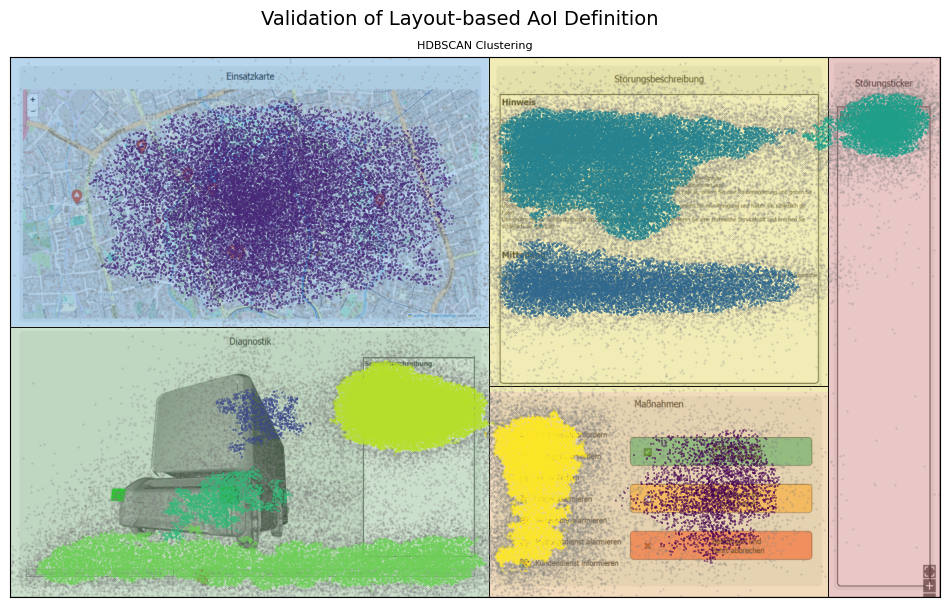

In [43]:
# Results
hdbscan_clusterer = hdbscan.HDBSCAN(min_cluster_size=100, min_samples=50, metric='euclidean')
df['cluster'] = hdbscan_clusterer.fit_predict(coordinates)
clusters = df[df['cluster'] != -1]
noise = df[df['cluster'] == -1]

visualize_with_bounds(clusters, noise, 'Validation of Layout-based AoI Definition', 'HDBSCAN Clustering')

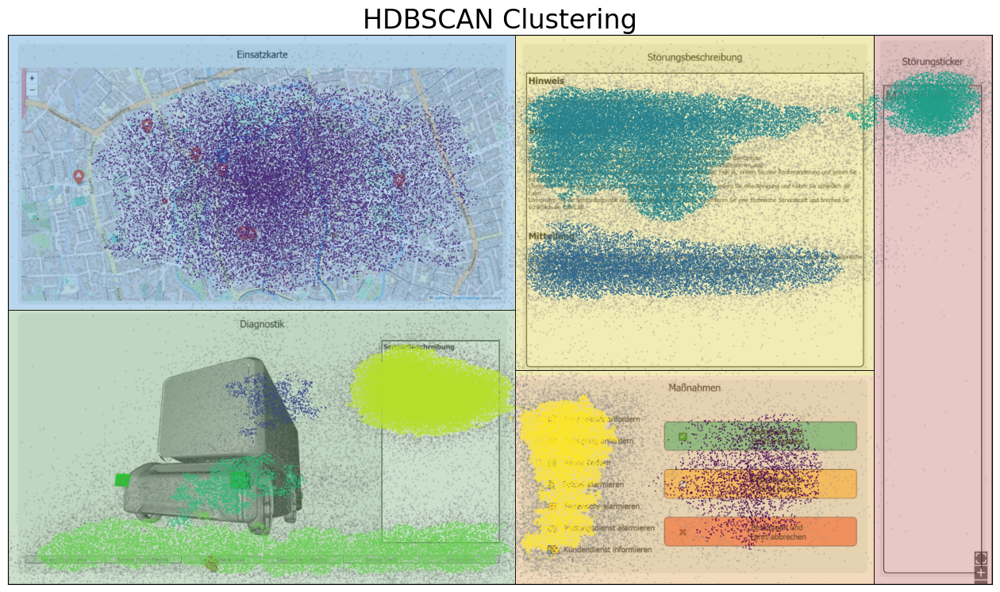

In [12]:
# Results2
# Define visualization function with aoi bounds
def visualize_with_bounds_nosubtitle(clusters, noise, title,):
    plt.figure(figsize=(16, 9))

    plt.title(title, fontsize=24, weight='medium')
    plt.imshow(
        bg_img,
        extent=(0, 1, 0, 1),
        aspect='auto'
    )

    ax = plt.gca()  # Get current axis
    for area_name, vertices in areas_of_interest.items():
        polygon = patches.Polygon(vertices, closed=True, fill=False, edgecolor='black', linewidth=.5)
        ax.add_patch(polygon)

    plt.scatter(clusters['norm_pos_x'], clusters['norm_pos_y'], 
                c=clusters['cluster'], s=.1, cmap='viridis', label='Clusters')
    plt.scatter(noise['norm_pos_x'], noise['norm_pos_y'], 
                c='grey', s=.1, alpha=0.5, label='Noise')

    plt.xlabel('', fontsize=20)
    plt.ylabel('', fontsize=20)
    plt.xticks([])
    plt.yticks([])
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.tick_params(axis='both', which='major', labelsize=16)
    plt.show()

hdbscan_clusterer = hdbscan.HDBSCAN(min_cluster_size=100, min_samples=50, metric='euclidean')
df['cluster'] = hdbscan_clusterer.fit_predict(coordinates)
clusters = df[df['cluster'] != -1]
noise = df[df['cluster'] == -1]

visualize_with_bounds_nosubtitle(clusters, noise, 'HDBSCAN Clustering')